In [1]:
%matplotlib inline
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import numpy as np
import scipy.integrate as spi
import matplotlib.patches as pt
from IPython import display

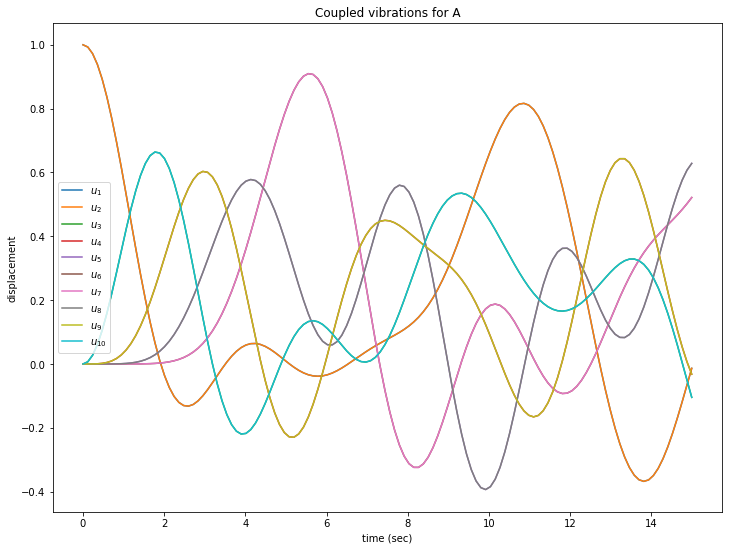

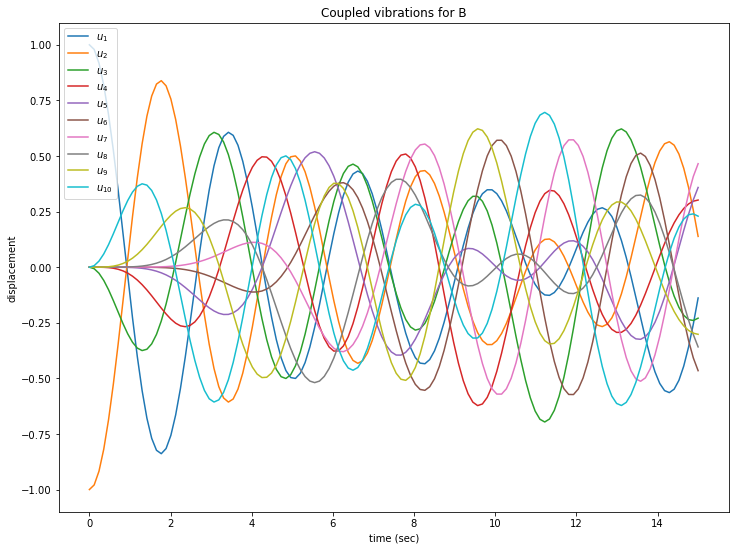

In [2]:
# ODEs

def coupledvibrations(y, t, param):
    d_var = np.zeros(20)
    C, M = param
    for n in range(10):
        d_var[n] = y[n+10]
        
        if n == 0:
            d_var[10] = C/M * (y[9]+y[1]-2*y[0])
            
        elif n == 9:
            
            d_var[19] = C/M * (y[8]+y[0]-2*y[9])
            
        else:
            d_var[n+10] = C/M * (y[n-1]+y[n+1]-2*y[n])
        
    return d_var

# Value of parameters
C = 1
M = 1
parameters = [C, M]

# Initial conditions
yA = np.zeros(20)
yA[0] = 1
yA[1] = 1
yB = np.zeros(20)
yB[0] = 1
yB[1] = -1

t_end = 15
N = 128
t = np.linspace(0, t_end, N)

# Solve

solutionA = spi.odeint(coupledvibrations, yA, t, args = (parameters,))
solutionAT = np.transpose(solutionA)

# Plot

fig1 = plt.figure(figsize = (12, 9))
plt.title("Coupled vibrations for A")
plt.xlabel("time (sec)")
plt.ylabel("displacement")
for n in range(10):
    plt.plot(t, solutionAT[n], label = "$u_{"+str(n+1)+"}$")
    plt.legend()
plt.show()

solutionB = spi.odeint(coupledvibrations, yB, t, args = (parameters,))
solutionBT = np.transpose(solutionB)

fig2 = plt.figure(figsize = (12, 9))
plt.title("Coupled vibrations for B")
plt.xlabel("time (sec)")
plt.ylabel("displacement")
for n in range(10):
    plt.plot(t, solutionBT[n], label = "$u_{"+str(n+1)+"}$")
    plt.legend()
plt.show()

In [3]:
fig3 = plt.figure(figsize = (12, 9))

speed = 20
t_end = 15
time = np.linspace(0, t_end, N)

plt.xlim(0, 11)
plt.ylim(-1.1, 1.1)

dot1, =  plt.plot([], [], 'o',markersize = 10)
dot2, =  plt.plot([], [], 'o',markersize = 10)
dot3, =  plt.plot([], [], 'o',markersize = 10)
dot4, =  plt.plot([], [], 'o',markersize = 10)
dot5, =  plt.plot([], [], 'o',markersize = 10)
dot6, =  plt.plot([], [], 'o',markersize = 10)
dot7, =  plt.plot([], [], 'o',markersize = 10)
dot8, =  plt.plot([], [], 'o',markersize = 10)
dot9, =  plt.plot([], [], 'o',markersize = 10)
dot10, =  plt.plot([], [], 'o',markersize = 10)

plt.close()

displacement = []
tlist = []

def funcdotA(x,n):
    i = x*N/t_end
    if i == 0:
        a = solutionAT[n][0]
    else :
        a = solutionAT[n][int(i)-1]
        
    return ([n+1], a)

def funcdotB(x,n):
    i = x*N/t_end
    if i == 0:
        a = solutionBT[n][0]
    else :
        a = solutionBT[n][int(i)-1]
        
    return ([n+1], a)
            
def init():
    dot1.set_data([], [])
    dot2.set_data([], [])
    dot3.set_data([], [])
    dot4.set_data([], [])
    dot5.set_data([], [])
    dot6.set_data([], [])
    dot7.set_data([], [])
    dot8.set_data([], [])
    dot9.set_data([], [])
    dot10.set_data([], [])
    return(dot1,dot2,dot3,dot4,dot5,dot6,dot7,dot8,dot9,dot10)

def animatedotA(k):   
    dot1.set_data(funcdotA(k,0))
    dot2.set_data(funcdotA(k,1))
    dot3.set_data(funcdotA(k,2))
    dot4.set_data(funcdotA(k,3))
    dot5.set_data(funcdotA(k,4))
    dot6.set_data(funcdotA(k,5))
    dot7.set_data(funcdotA(k,6))
    dot8.set_data(funcdotA(k,7))
    dot9.set_data(funcdotA(k,8))
    dot10.set_data(funcdotA(k,9))
    return(dot1,dot2,dot3,dot4,dot5,dot6,dot7,dot8,dot9,dot10)

def animatedotB(k):   
    dot1.set_data(funcdotB(k,0))
    dot2.set_data(funcdotB(k,1))
    dot3.set_data(funcdotB(k,2))
    dot4.set_data(funcdotB(k,3))
    dot5.set_data(funcdotB(k,4))
    dot6.set_data(funcdotB(k,5))
    dot7.set_data(funcdotB(k,6))
    dot8.set_data(funcdotB(k,7))
    dot9.set_data(funcdotB(k,8))
    dot10.set_data(funcdotB(k,9))
    return(dot1,dot2,dot3,dot4,dot5,dot6,dot7,dot8,dot9,dot10)

# Animate

displacementA_ani = animation.FuncAnimation(fig3, animatedotA, time, blit = True, interval = 1000/speed, init_func = init)
#display.HTML(displacementA_ani.to_html5_video())
display.HTML(displacementA_ani.to_jshtml())



In [4]:
fig4 = plt.figure(figsize = (12, 9))

plt.xlim(0, 11)
plt.ylim(-1.1, 1.1)

dot1, =  plt.plot([], [], 'o',markersize = 10)
dot2, =  plt.plot([], [], 'o',markersize = 10)
dot3, =  plt.plot([], [], 'o',markersize = 10)
dot4, =  plt.plot([], [], 'o',markersize = 10)
dot5, =  plt.plot([], [], 'o',markersize = 10)
dot6, =  plt.plot([], [], 'o',markersize = 10)
dot7, =  plt.plot([], [], 'o',markersize = 10)
dot8, =  plt.plot([], [], 'o',markersize = 10)
dot9, =  plt.plot([], [], 'o',markersize = 10)
dot10, =  plt.plot([], [], 'o',markersize = 10)

plt.close()

displacement = []
tlist = []

# Animate
displacementB_ani = animation.FuncAnimation(fig4, animatedotB, time, blit = True, interval = 1000/speed, init_func = init)
#display.HTML(displacementB_ani.to_html5_video())
display.HTML(displacementB_ani.to_jshtml())


In [5]:
displacement = [[],[],[],[],[],[],[],[],[],[]]
tlist = [[],[],[],[],[],[],[],[],[],[]]
fig5 = plt.figure(figsize = (12, 9))

speed = 20
t_end = 15

plt.xlim(0, 15)
plt.ylim(-0.5, 1.1)

line1, = plt.plot([], [])
line2, = plt.plot([], [])
line3, = plt.plot([], [])
line4, = plt.plot([], [])
line5, = plt.plot([], [])
line6, = plt.plot([], [])
line7, = plt.plot([], [])
line8, = plt.plot([], [])
line9, = plt.plot([], [])
line10, = plt.plot([], [])

plt.close()

def functime(x,n):
    b = x
    tlist[n].append(b)
    return tlist[n]

def funcA(x,n):
    i = x*N/t_end
    if i == 0:
        a = solutionAT[n][0]
    else :
        a = solutionAT[n][int(i)-1]   
    displacement[n].append(a)
    return displacement[n]

def funcB(x,n):
    i = x*N/t_end
    if i == 0:
        a = solutionBT[n][0]
    else :
        a = solutionBT[n][int(i)-1]   
    displacement[n].append(a)
    return displacement[n]

def init():
    line1.set_data([], [])
    line2.set_data([], [])
    line3.set_data([], [])
    line4.set_data([], [])
    line5.set_data([], [])
    line6.set_data([], [])
    line7.set_data([], [])
    line8.set_data([], [])
    line9.set_data([], [])
    line10.set_data([], [])
    return(line1,line2,line3,line4,line5,line6,line7,line8,line9,line10)

def animatelineA(k):   
    line1.set_data(functime(k,0), funcA(k,0)) 
    line2.set_data(functime(k,1), funcA(k,1)) 
    line3.set_data(functime(k,2), funcA(k,2)) 
    line4.set_data(functime(k,3), funcA(k,3)) 
    line5.set_data(functime(k,4), funcA(k,4)) 
    line6.set_data(functime(k,5), funcA(k,5)) 
    line7.set_data(functime(k,6), funcA(k,6)) 
    line8.set_data(functime(k,7), funcA(k,7)) 
    line9.set_data(functime(k,8), funcA(k,8)) 
    line10.set_data(functime(k,9), funcA(k,9))
    return(line1,line2,line3,line4,line5,line6,line7,line8,line9,line10)

def animatelineB(k):   
    line1.set_data(functime(k,0), funcB(k,0)) 
    line2.set_data(functime(k,1), funcB(k,1)) 
    line3.set_data(functime(k,2), funcB(k,2)) 
    line4.set_data(functime(k,3), funcB(k,3)) 
    line5.set_data(functime(k,4), funcB(k,4)) 
    line6.set_data(functime(k,5), funcB(k,5)) 
    line7.set_data(functime(k,6), funcB(k,6)) 
    line8.set_data(functime(k,7), funcB(k,7)) 
    line9.set_data(functime(k,8), funcB(k,8)) 
    line10.set_data(functime(k,9), funcB(k,9))
    return(line1,line2,line3,line4,line5,line6,line7,line8,line9,line10)

# Animate

displacementA_ani = animation.FuncAnimation(fig5, animatelineA, time, interval = 1000/speed, init_func = init)
#display.HTML(displacementA_ani.to_html5_video())
display.HTML(displacementA_ani.to_jshtml())



In [6]:
displacement = [[],[],[],[],[],[],[],[],[],[]]
tlist = [[],[],[],[],[],[],[],[],[],[]]
fig6 = plt.figure(figsize = (12, 9))

speed = 20
t_end = 15

plt.xlim(0, 15)
plt.ylim(-1.1, 1.1)

line1, = plt.plot([], [])
line2, = plt.plot([], [])
line3, = plt.plot([], [])
line4, = plt.plot([], [])
line5, = plt.plot([], [])
line6, = plt.plot([], [])
line7, = plt.plot([], [])
line8, = plt.plot([], [])
line9, = plt.plot([], [])
line10, = plt.plot([], [])

plt.close()

# Animate

displacementB_ani = animation.FuncAnimation(fig6, animatelineB, time, interval = 1000/speed, init_func = init)
#display.HTML(displacementB_ani.to_html5_video())
display.HTML(displacementB_ani.to_jshtml())